# Storage Model
### TC2008B. Modelación de sistemas multiagentes con gráficas computacionales
José Emilaino Riosmena Castañón - A01704245

In [30]:
# Import necessary modules from the Mesa library
from mesa import Agent, Model
from mesa.time import SimultaneousActivation
from mesa.space import MultiGrid
from mesa.datacollection import DataCollector

# Enable inline plotting for Jupyter Notebooks
%matplotlib inline
import matplotlib
import matplotlib.pyplot as plt
import matplotlib.animation as animation

# Set the animation format to 'jshtml' for Jupyter Notebooks
plt.rcParams["animation.html"] = "jshtml"

# Adjust the animation embed limit
matplotlib.rcParams['animation.embed_limit'] = 2**128

# Import additional libraries for data handling and randomness
import numpy as np
import pandas as pd
import random

# Import modules for handling date and time
import datetime
import time


In [31]:
class StorageAgent(Agent):
    def __init__(self, id, model):
        # Initialize the StorageAgent with an ID and a reference to the model
        super().__init__(id, model)
        self.id = id

        # Initialize attributes for the box, target, and box positions on the grid
        self.box = ()
        self.target = ()
        self.box_position = np.zeros((model.grid.width, model.grid.height), dtype=int)

    def step(self):
        # Initialize variables for the agent's position and possible movement steps
        position = ()
        possible_steps = self.model.grid.get_neighborhood(self.pos, moore=False, include_center=False)

        # Iterate through possible steps to check for boxes at neighboring positions
        for i in possible_steps:
            (x, y) = i

            # If there is a box at the current position
            if self.model.boxes[x][y] > 0:
                # Update the box position matrix and handle box pickup
                self.box_position[x][y] = self.model.boxes[x][y]

                if len(self.box) > 0 and self.model.boxes[x][y] < 5:
                    self.box = ()
                    self.model.boxes[x][y] += 1
                    self.box_position[x][y] += 1
                    self.model.pickedup_boxes -= 1

        # Choose a random position for the agent to move
        position = random.choice(possible_steps)

        # Ensure the chosen position is not occupied by a box or another agent
        while self.model.boxes[position] > 0 or self.box_position[position] > 0:
            position = random.choice(possible_steps)

        # Move the agent to the chosen position on the grid
        self.model.grid.move_agent(self, position)
        self.pos = position

In [32]:
def getRobots(model):
    # Retrieve the positions of all agents in the model
    return np.asarray([agent.pos for agent in model.schedule.agents])

def getBoxes(model):
    # Retrieve the matrix representing the distribution of boxes in the model
    return model.boxes

In [33]:
class StorageModel(Model):
    def __init__(self, width, height, num_agents, boxes):
        # Initialize the model with the specified width, height, number of agents, and initial box distribution
        self.schedule = SimultaneousActivation(self)
        self.grid = MultiGrid(width, height, torus=False)
        self.boxes = np.zeros((width, height), dtype=int)
        self.pickedup_boxes = 0

        # Set up data collection for tracking robots and box distribution
        self.datacollector = DataCollector(model_reporters={"Robots": getRobots, "Boxes": getBoxes})
        
        # Randomly distribute initial boxes on the grid
        initial_boxes = 0
        while initial_boxes < boxes:
            x, y = np.random.randint(0, width), np.random.randint(0, height)
            if self.boxes[x, y] < 3:
                self.boxes[x, y] += 1
                initial_boxes += 1

        # Initialize agent positions while avoiding positions with boxes
        agent_positions = []
        while len(agent_positions) < num_agents:
            x, y = np.random.randint(0, width), np.random.randint(0, height)
            if (x, y) not in agent_positions and self.boxes[x, y] == 0:
                # Create a StorageAgent, add it to the schedule, and place it on the grid
                agent = StorageAgent(len(agent_positions), self)
                self.schedule.add(agent)
                self.grid.place_agent(agent, (x, y))
                agent_positions.append((x, y))

    def step(self):
        # Collect data, then advance the model by one step
        self.datacollector.collect(self)
        self.schedule.step()

In [34]:
# Set the dimensions of the grid
WIDTH = 20
HEIGHT = 20

# Set the number of agents, iterations, initial boxes, and a seed for reproducibility
NUM_AGENTS = 5
ITERATIONS = 1000
BOXES = 200
SEED = 67890
random.seed(SEED)

# Create an instance of the StorageModel with the specified parameters
model = StorageModel(WIDTH, HEIGHT, NUM_AGENTS, BOXES)

# Initialize an empty list to store box data for each iteration
box_data = []

# Run the simulation for the specified number of iterations
for i in range(ITERATIONS):
    # Advance the model by one step and collect box data
    model.step()
    box_data.append(model.datacollector.get_model_vars_dataframe()["Boxes"].iloc[0].copy())

# Display a completion message and the total number of initial boxes
print("Done!")
print("Number of boxes: ", BOXES)

Done!
Number of boxes:  200


In [35]:
# Retrieve the positions of all agents and the distribution of boxes for each iteration
all_positions = model.datacollector.get_model_vars_dataframe()

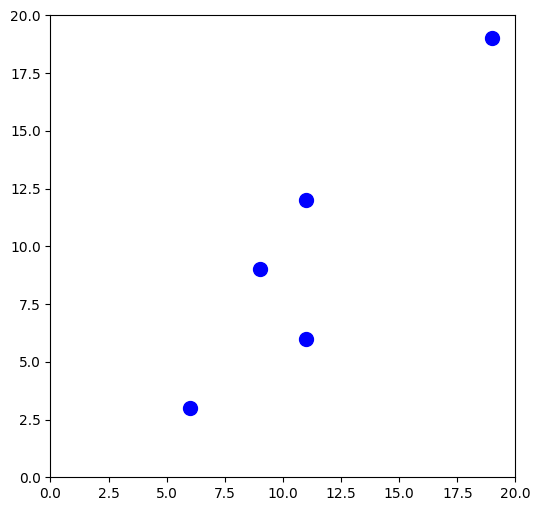

In [36]:
# Create a scatter plot to visualize the movement of agents over iterations
fig, ax = plt.subplots(figsize=(6, 6))
scatter = ax.scatter(all_positions.iloc[0][0][:, 0], all_positions.iloc[0][0][:, 1], c="blue", s=100)

# Set the axis limits based on the width and height of the grid
ax.axis([0, WIDTH, 0, HEIGHT])

# Define an animation function to update the scatter plot for each iteration
def animate(i):
    scatter.set_offsets(all_positions.iloc[i][0])
    return scatter

# Create an animation using the animate function and the specified number of frames
anim = animation.FuncAnimation(fig, animate, frames=ITERATIONS)

In [37]:
# Display the animation of agent movement over iterations
# anim

Number of boxes:  200


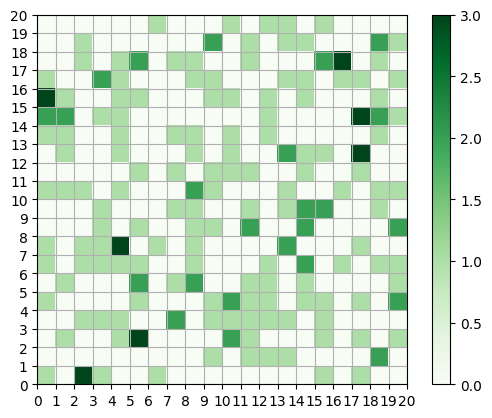

In [38]:
# Extract box positions from the first iteration's data and initialize a count matrix
box_positions = all_positions.iloc[0][1]
count = np.zeros((WIDTH, HEIGHT), dtype=int)

# Initialize a variable to count the total number of boxes
boxes = 0

# Iterate through grid positions and populate the count matrix with box counts
for i in range(model.grid.width):
    for j in range(model.grid.height):
        count[j][i] = box_positions[i][j]
        boxes += box_positions[i][j]

# Display the total number of boxes in the simulation
print("Number of boxes: ", boxes)

# Set up a colormap for visualization
cmap = plt.cm.Greens

# Create an image plot to visualize the distribution of boxes on the grid
plt.imshow(count, cmap=cmap, interpolation='nearest', origin='lower', extent=[0, WIDTH, 0, HEIGHT])

# Add a color bar for reference
plt.colorbar()

# Set axis ticks and labels
plt.xticks(np.arange(0, HEIGHT+1, 1))
plt.yticks(np.arange(0, WIDTH+1, 1))

# Display grid lines
plt.grid(True)
